# Predicting Bad Deliveries

## Background
Delivery Hero delivers millions of order in a day. As it is obvious that all the orders can't be performed smoothly. 


## Aim of this study
Finding the bad delivery based on data and predicting drop_off time 

Following reasons can lead to bad delivery:

    1. Orders can be bad delivered  because of wrong address info, wrong instructions, etc
    2. Festival, daily and weekly order pattern
    3. Due to unfamilarity of delivery partner to delivery location 
    4. GPS signal unavailability 
    5. Natural events like rain, 
    6. Traffic related things can lead to delay and undelivered in expected time
    
 Our main focus will be 1 & 2. Others we can explore any possibility of including into model

# EDA 

In [2]:
# importing packages

import pandas as pd
import pandas
import matplotlib.pyplot as plt

#to encode deohash
from geolib import geohash
import pygeohash as gh
import seaborn as sns
# geohash.decode('w23bh248')
import datashader as ds
import colorcet
import datetime

Previously run geohash decode part and saved into csv now only reading that. 

## Data Cleaning and Transformation

In [71]:
# function to decode the geohash
def decode_geohash(x):
    return geohash.decode(x)

In [277]:
# location_data = pd.read_json('location_task_no_nulls.json')
location_data = pd.read_csv('location_data.csv')

In [70]:
location_data

,order_id,order_value,order_items_count,customer_id,created_timestamp_local,has_instruction,logistics_dropoff_distance,delivery_postal_code,delivery_geohash_precision8,has_phone_number,...,has_lift_instruction,has_lobby_instruction,has_gate_instruction,has_knock_instruction,has_bell_instruction,location,longitude,latitude,date,time_hour
0,b8ds-tqhf,40.44,10,h6huq0td,2021-03-11 20:19:50,True,58.656138,828868.0,w23bh248,False,...,False,False,False,False,False,"Point(lat=Decimal('1.4063358306884765625'), lo...",1.406336,103.901310,2021-03-11,20
1,x5xx-j2d2,35.60,10,t2nod4rq,2021-03-12 18:42:48,True,39.025148,530548.0,w21zu55k,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3795566558837890625'), lo...",1.379557,103.891354,2021-03-12,18
2,x6qu-14kt,42.49,12,m4ycd3tm,2021-03-27 11:29:17,True,40.067811,650248.0,w21z9jc4,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3503742218017578125'), lo...",1.350374,103.756428,2021-03-27,11
3,x3yw-rhc5,14.40,11,sgmnf9sb,2021-03-02 22:08:52,True,44.986785,550105.0,w21zg97y,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3702869415283203125'), lo...",1.370287,103.870068,2021-03-02,22
4,y9zp-58q7,38.15,10,x4rvv3iy,2021-03-23 20:35:26,True,71.520828,102112.0,w21z61q6,False,...,False,False,False,False,False,"Point(lat=Decimal('1.2817096710205078125'), lo...",1.281710,103.807583,2021-03-23,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2347894,x8yk-i47h,52.25,9,sgoaf8gi,2021-03-08 11:00:31,True,52.579262,760709.0,w23b4shg,True,...,False,False,False,False,False,"Point(lat=Decimal('1.4288234710693359375'), lo...",1.428823,103.827496,2021-03-08,11
2347895,x1sy-lx5r,40.90,9,d1wdv0nu,2021-03-05 08:45:19,True,28.240697,752469.0,w23b4rds,True,...,False,False,False,False,False,"Point(lat=Decimal('1.4482212066650390625'), lo...",1.448221,103.813419,2021-03-05,8
2347896,y5qw-ysmi,27.95,9,b0xww0xs,2021-03-27 14:01:28,True,95.709786,521247.0,w21ztq5v,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3522624969482421875'), lo...",1.352262,103.946972,2021-03-27,14
2347897,w6zq-rog9,16.00,9,r2hxi4hb,2021-03-04 17:24:34,True,8.457068,753128.0,w23b4ycr,False,...,False,False,False,True,False,"Point(lat=Decimal('1.4446163177490234375'), lo...",1.444616,103.833675,2021-03-04,17


In [4]:
location_data['location'] = location_data['delivery_geohash_precision8'].apply(decode_geohash)

NameError: name 'decode_geohash' is not defined

In [5]:
location_data['longitude'], location_data['latitude'] = location_data.apply(lambda row: row['location'][0], axis=1), location_data.apply(lambda row: row['location'][1],axis=1)

In [20]:
# checking memory usage of data
location_data.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2347899 entries, 0 to 2347898
Data columns (total 22 columns):
 #   Column                       Dtype  
---  ------                       -----  
 0   order_id                     object 
 1   order_value                  float64
 2   order_items_count            int64  
 3   customer_id                  object 
 4   created_timestamp_local      object 
 5   has_instruction              bool   
 6   logistics_dropoff_distance   float64
 7   delivery_postal_code         float64
 8   delivery_geohash_precision8  object 
 9   has_phone_number             bool   
 10  has_call_instruction         bool   
 11  has_leave_instruction        bool   
 12  has_lift_instruction         bool   
 13  has_lobby_instruction        bool   
 14  has_gate_instruction         bool   
 15  has_knock_instruction        bool   
 16  has_bell_instruction         bool   
 17  location                     object 
 18  longitude                    object 
 19  

In [21]:
# Missing value 
location_data.isnull().sum()

order_id                       0
order_value                    0
order_items_count              0
customer_id                    0
created_timestamp_local        0
has_instruction                0
logistics_dropoff_distance     0
delivery_postal_code           0
delivery_geohash_precision8    0
has_phone_number               0
has_call_instruction           0
has_leave_instruction          0
has_lift_instruction           0
has_lobby_instruction          0
has_gate_instruction           0
has_knock_instruction          0
has_bell_instruction           0
location                       0
longitude                      0
latitude                       0
date                           0
time_hour                      0
dtype: int64

In [22]:
location_data.head()

,order_id,order_value,order_items_count,customer_id,created_timestamp_local,has_instruction,logistics_dropoff_distance,delivery_postal_code,delivery_geohash_precision8,has_phone_number,...,has_lift_instruction,has_lobby_instruction,has_gate_instruction,has_knock_instruction,has_bell_instruction,location,longitude,latitude,date,time_hour
0,b8ds-tqhf,40.44,10,h6huq0td,2021-03-11 20:19:50,True,58.656138,828868.0,w23bh248,False,...,False,False,False,False,False,"Point(lat=Decimal('1.4063358306884765625'), lo...",P,o,2021-03-11,20
1,x5xx-j2d2,35.60,10,t2nod4rq,2021-03-12 18:42:48,True,39.025148,530548.0,w21zu55k,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3795566558837890625'), lo...",P,o,2021-03-12,18
2,x6qu-14kt,42.49,12,m4ycd3tm,2021-03-27 11:29:17,True,40.067811,650248.0,w21z9jc4,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3503742218017578125'), lo...",P,o,2021-03-27,11
3,x3yw-rhc5,14.40,11,sgmnf9sb,2021-03-02 22:08:52,True,44.986785,550105.0,w21zg97y,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3702869415283203125'), lo...",P,o,2021-03-02,22
4,y9zp-58q7,38.15,10,x4rvv3iy,2021-03-23 20:35:26,True,71.520828,102112.0,w21z61q6,False,...,False,False,False,False,False,"Point(lat=Decimal('1.2817096710205078125'), lo...",P,o,2021-03-23,20


In [72]:
location_data['delivery_postal_code'] = location_data['delivery_postal_code'].apply(pd.to_numeric, errors='coerce').dropna()

In [73]:
# dropping off the rows which have wrong postal information 

location_data = location_data.dropna()

## Pandas Profiling - Quick EDA 

In [278]:
from pandas_profiling import ProfileReport

profile = ProfileReport(location_data, title="EDA Report")

In [279]:
profile

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Remark from Pandas Profiling:

    1. 'delivery_postal_code' column has missing values around 
    2. 'has_call_instructions' and 'has_phone_number' are correlated
    3. Similarly, 'order_value' and 'order_items_count' are correlated
    4. For boolen columns i.e. 'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction','has_knock_instruction', 'has_bell_instruction', majority is false   
       i.e. not present in delivery information.
    5. 565549 are unique customer, from data it is validated that same customer have same id on different date as their                  geographical location matching 
       

## Customer  Analysis

In [74]:
# frequency of same customer_id
location_data.customer_id.value_counts()[location_data.customer_id.value_counts()>=30]

a1hqj0ax    311
sgijd3to    143
sgdtqv9x    125
y9upa2tt    122
j9lcy7pz    117
           ... 
g1bgx3ar     30
f1lvl7sx     30
sgexk2te     30
sgcu5pvh     30
o3qhu7wp     30
Name: customer_id, Length: 5208, dtype: int64

5826 out of 565549 customers ordered atleast one order a day in month of March 

Can be tagged as regular customer 

And we can assume that thier instructions and location and other information is correct and treated less chance to contribute to logistics drop off distance



In [75]:
location_data.customer_id.value_counts()[location_data.customer_id.value_counts()>=30]

a1hqj0ax    311
sgijd3to    143
sgdtqv9x    125
y9upa2tt    122
j9lcy7pz    117
           ... 
g1bgx3ar     30
f1lvl7sx     30
sgexk2te     30
sgcu5pvh     30
o3qhu7wp     30
Name: customer_id, Length: 5208, dtype: int64

<AxesSubplot:>

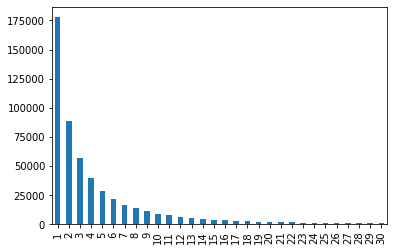

In [80]:
# plot of unique customer in the dataset who order 30 or less than 30 times over month
location_data.customer_id.value_counts()[(location_data.customer_id.value_counts()<=30)].value_counts().plot(kind='bar')

<AxesSubplot:>

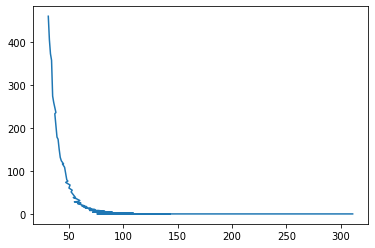

In [81]:
# plot of unique customer in the dataset who order greater than 30 times over month and its count 
location_data.customer_id.value_counts()[(location_data.customer_id.value_counts()>30)].value_counts().plot()

In [82]:
# finding list of customer having 30 and more orders in a month of data provided
customer_data = location_data.groupby('customer_id').agg('count').reset_index()
regular_customer = customer_data[customer_data['order_id']>=30]['customer_id']

In [83]:
len(location_data[(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']<=500)])

205696

<b> Assumption that if drop off distance is more than 100 it is bad deliveries <b>

In [84]:
print('No of regular customer less than 100 logistics_dropoff_distance : {}'.format(len(location_data[(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']<=100)])))
print('No of regular customer more than 100 logistics_dropoff_distance : {}'.format(len(location_data[(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']>100)])))
print('No of ordinary customer less than 100 logistics_dropoff_distance : {}'.format(len(location_data[~(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']<=100)])))
print('No of ordinary customer more than 100 logistics_dropoff_distance : {}'.format(len(location_data[~(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']>100)])))

No of regular customer less than 100 logistics_dropoff_distance : 189438
No of regular customer more than 100 logistics_dropoff_distance : 18651
No of ordinary customer less than 100 logistics_dropoff_distance : 1932657
No of ordinary customer more than 100 logistics_dropoff_distance : 207153


In [85]:
print('percent bad deliveries with regular customers: ',round(18651/(18651+189438)*100,2),'%')

percent bad deliveries with regular customers:  8.96 %


In [86]:
print('percent bad deliveries with ordinary customers: ',round(207153/(1932657+207153)*100,2),'%')

percent bad deliveries with ordinary customers:  9.68 %


<AxesSubplot:xlabel='logistics_dropoff_distance', ylabel='Count'>

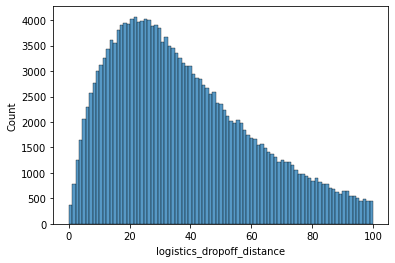

In [87]:
# plotting histogram to check logistics dropoff distance variation for regular customer 
sns.histplot(location_data[(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']<=100)]['logistics_dropoff_distance'])

<AxesSubplot:xlabel='logistics_dropoff_distance', ylabel='Count'>

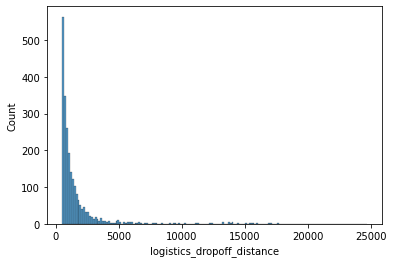

In [88]:
# plotting histogram to check logistics dropoff distance variation for regular customer 
sns.histplot(location_data[(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']>500)]['logistics_dropoff_distance'])

<AxesSubplot:xlabel='logistics_dropoff_distance', ylabel='Count'>

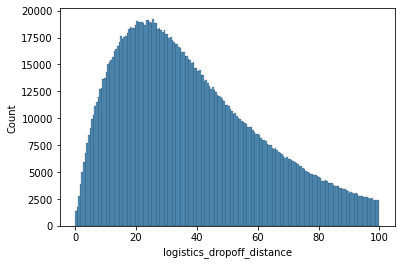

In [14]:
# plotting histogram to check logistics dropoff distance variation for ordinary customer 
sns.histplot(location_data[~(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']<=100)]['logistics_dropoff_distance'])

<AxesSubplot:xlabel='logistics_dropoff_distance', ylabel='Count'>

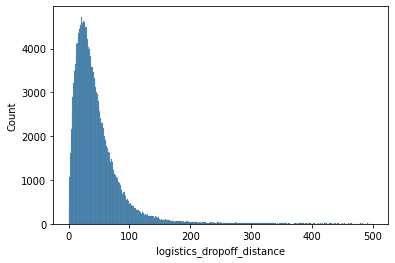

In [15]:
sns.histplot(location_data[(location_data['customer_id'].isin(regular_customer))&(location_data['logistics_dropoff_distance']<=500)]['logistics_dropoff_distance'])

## Time Series Analysis

In [90]:
location_data['created_timestamp_local'] = pd.to_datetime(location_data['created_timestamp_local'])

In [91]:
location_data['date'] = location_data['created_timestamp_local'].dt.date

In [92]:
import plotly.express as px

df = location_data.groupby('date').agg('count').reset_index()
fig = px.line(df, x='date', y="order_id",title='No of orders across month',
             labels={
                     "order_id": "Order Count",
                 },)
fig.update_xaxes(
    dtick="D3",)
fig.show()

<b> From above plot we can clearly see weekly pattern and rise in no of orders on weekend i.e. saturday and sunday

In [93]:
location_data['time_hour'] = location_data['created_timestamp_local'].dt.hour

In [94]:
import plotly.express as px

df = location_data.groupby('time_hour').agg('count').reset_index()
fig = px.line(df, x='time_hour', y="order_id",title='No of orders across day',
             labels={
                     "order_id": "Order Count",
                 },)
fig.update_xaxes(
    dtick="D3",)
fig.show()

<b> From above plot we can clearly see hourly pattern and rise in no of orders at lunch and dinner time

In [95]:
import plotly.express as px

df = location_data[location_data['logistics_dropoff_distance']<5000].groupby('date').agg('mean').reset_index()
fig = px.line(df, x='date', y="logistics_dropoff_distance",title='Mean dropoff distance across month',
             labels={
                     "logistics_dropoff_distance": "Dropoff Distance",
                 },)
fig.update_xaxes(
    dtick="D3",)
fig.show()

we can observe from above plot that drop off distance across month have not pattern as such

In [96]:
import plotly.express as px

df = location_data[location_data['logistics_dropoff_distance']<5000].groupby('time_hour').agg('mean').reset_index()
fig = px.line(df, x='time_hour', y="logistics_dropoff_distance",title='Mean dropoff distance across day',
             labels={
                     "logistics_dropoff_distance": "Dropoff Distance",
                 },)
fig.update_xaxes(
    dtick="D3",)
fig.show()

we can observe from above plot that drop off distance across day have some patterns, 

-time at which high number of orders (i.e. *lunch and dinner time* ) and

-*late night* orders also lead to high drop off dinner

In [97]:
location_data.columns


Index(['order_id', 'order_value', 'order_items_count', 'customer_id',
       'created_timestamp_local', 'has_instruction',
       'logistics_dropoff_distance', 'delivery_postal_code',
       'delivery_geohash_precision8', 'has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction', 'location',
       'longitude', 'latitude', 'date', 'time_hour'],
      dtype='object')

In [98]:
location_data.columns
to_plot = ['has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction']

In [99]:
import plotly.express as px

df = location_data[location_data['logistics_dropoff_distance']<5000].groupby('date').agg('mean').reset_index()


fig = px.line(df, x='date', y=to_plot,title='Mean dropoff distance across day',
             labels={
                     "logistics_dropoff_distance": "Dropoff Distance",
                 },)
fig.update_xaxes(
    dtick="D3",)
fig.show()

We can observe that orders have consistent across the month on the bool columns, as it is mean over the month it is supposed to be like that

## Geospatial Analysis

In [100]:
cvs = ds.Canvas(plot_width=850, plot_height=600)
agg = cvs.points(location_data, 'longitude', 'latitude')
img = ds.tf.shade(agg, cmap='darkblue')

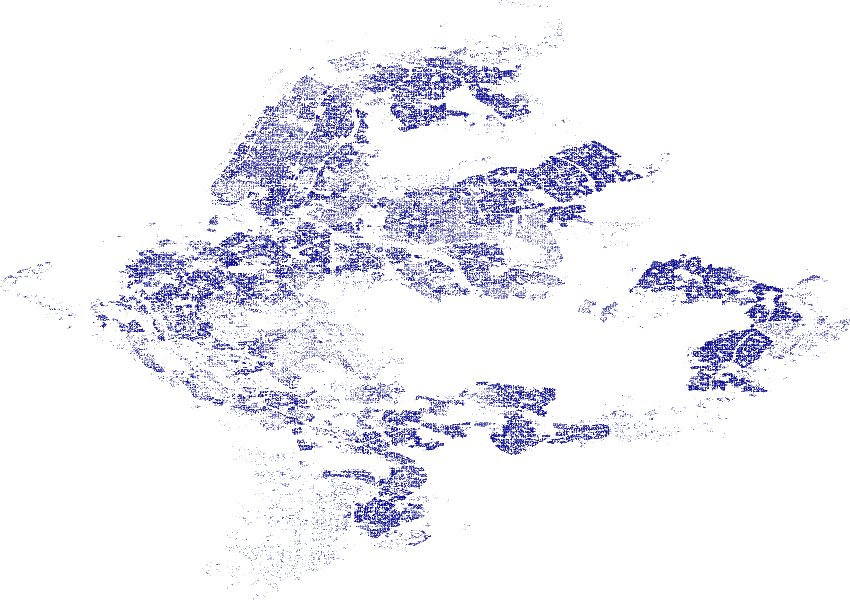

In [101]:
img

Above map, we can observe the density of orders placed across singapore 

In [ ]:
location_data['created_timestamp_local'] = pd.to_datetime(location_data['created_timestamp_local'], format ='%Y-%m-%dT%H:%M:%S')

<AxesSubplot:xlabel='created_timestamp_local'>

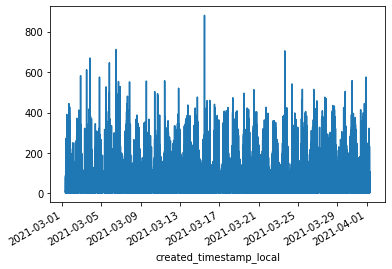

In [103]:
location_data.groupby('created_timestamp_local').agg(sum)['order_value'].plot()

<AxesSubplot:>

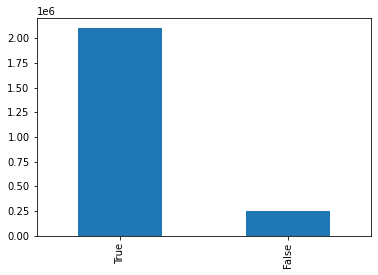

In [104]:
location_data['has_instruction'].value_counts().plot(kind='bar')

<AxesSubplot:>

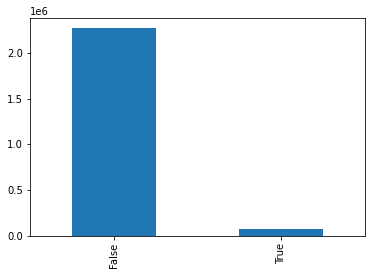

In [105]:
location_data['has_phone_number'].value_counts().plot(kind='bar')

In [107]:
# data

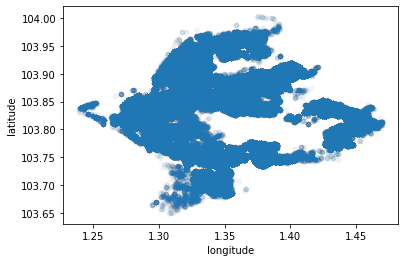

In [108]:
location_data.plot(kind="scatter", x="longitude", y="latitude", alpha=0.01)
plt.show()

In [109]:
location_data['longitude'] = location_data['longitude'].astype(float)
location_data['latitude'] = location_data['latitude'].astype(float)

In [110]:
cvs = ds.Canvas(plot_width=850, plot_height=600)
agg = cvs.points(location_data, 'longitude', 'latitude')
img = ds.tf.shade(agg, cmap='darkblue')

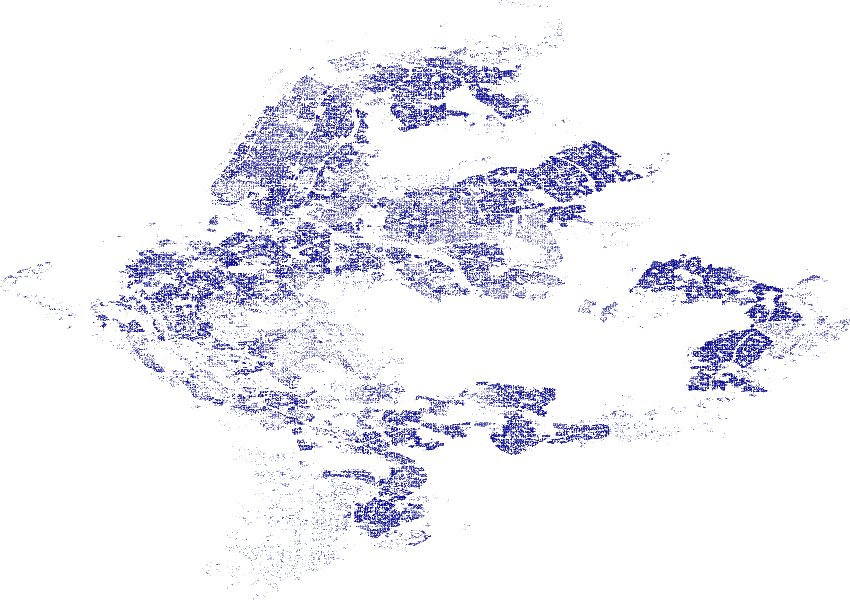

In [111]:
img

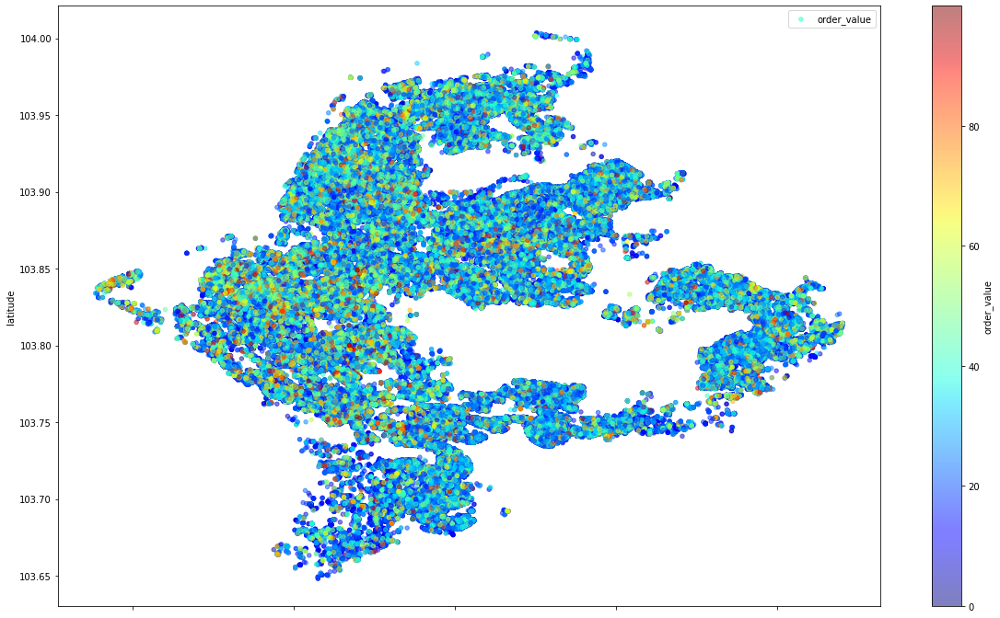

In [112]:
location_data[location_data['order_value']<100].plot(kind="scatter", x="longitude", y="latitude",
    label="order_value",
    c="order_value", cmap=plt.get_cmap("jet"),
    colorbar=True, alpha=0.5, figsize=(20,12),
)
plt.legend()
# save_fig("logistics_dropoff_distance")
plt.show()

From above map, we infer some 
1. In south singapore mostly order values are in range of 0 to 40 (roughly)
2. In north and west singapore mostly order values are in range of 30 - 60 (roughly)
3. And east and central singapore order values are in mid range i.e. 20 - 50 (roughly)

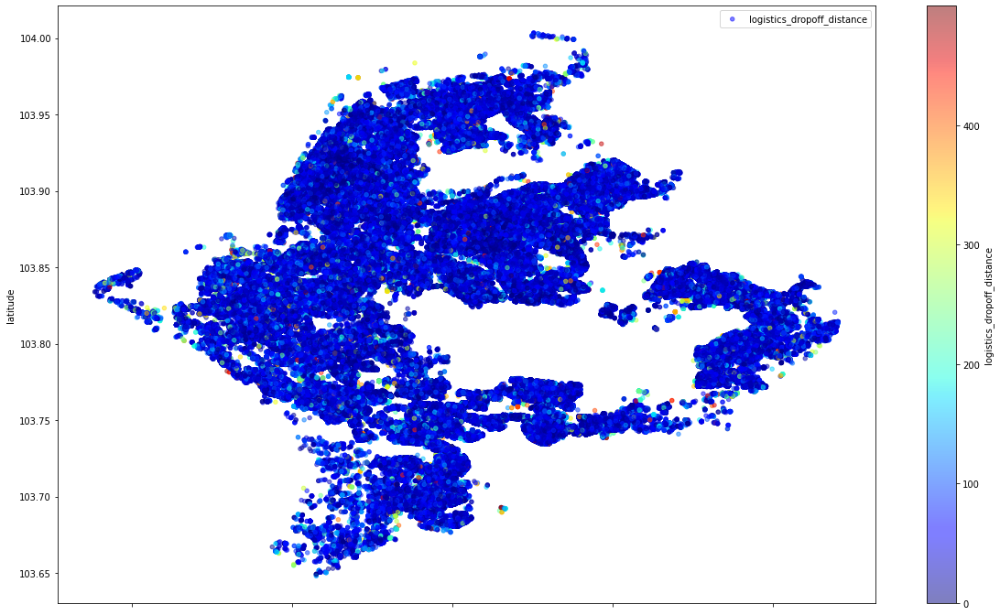

In [113]:
location_data[location_data['logistics_dropoff_distance']<=500].plot(kind="scatter", x="longitude", y="latitude",
    label="logistics_dropoff_distance",
    c="logistics_dropoff_distance", cmap=plt.get_cmap("jet"),
    colorbar=True, alpha=0.5, figsize=(20,12),
)
plt.legend()
# save_fig("logistics_dropoff_distance")
plt.show()

Drop off distance, it seems mostly less than 100 and it is spread across all over the singapore evenly

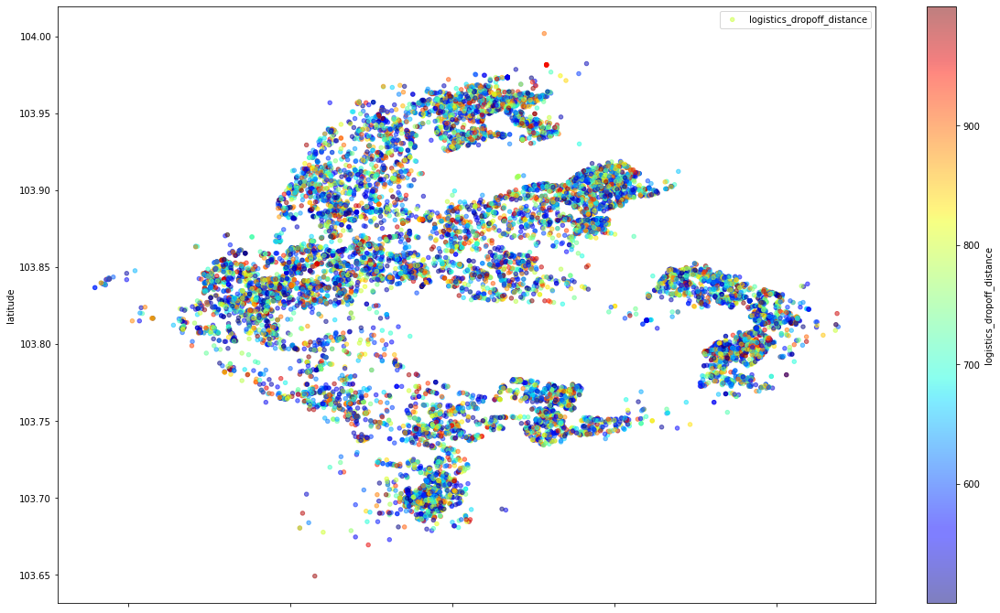

In [114]:
location_data[(location_data['logistics_dropoff_distance']>500)&(location_data['logistics_dropoff_distance']<1000)].plot(kind="scatter", x="longitude", y="latitude",
    label="logistics_dropoff_distance",
    c="logistics_dropoff_distance", cmap=plt.get_cmap("jet"),
    colorbar=True, alpha=0.5, figsize=(20,12),
)
plt.legend()
# save_fig("logistics_dropoff_distance")
plt.show()

Same map density plot for drop off distance between 500 to 1000 , can observe mostly between 500 to 650, Can also observe that many high drop off distance also spread across singapore 

In [115]:
len(location_data[(location_data['logistics_dropoff_distance']>1000)&(location_data['logistics_dropoff_distance']<10000)])

13322

## Other plots

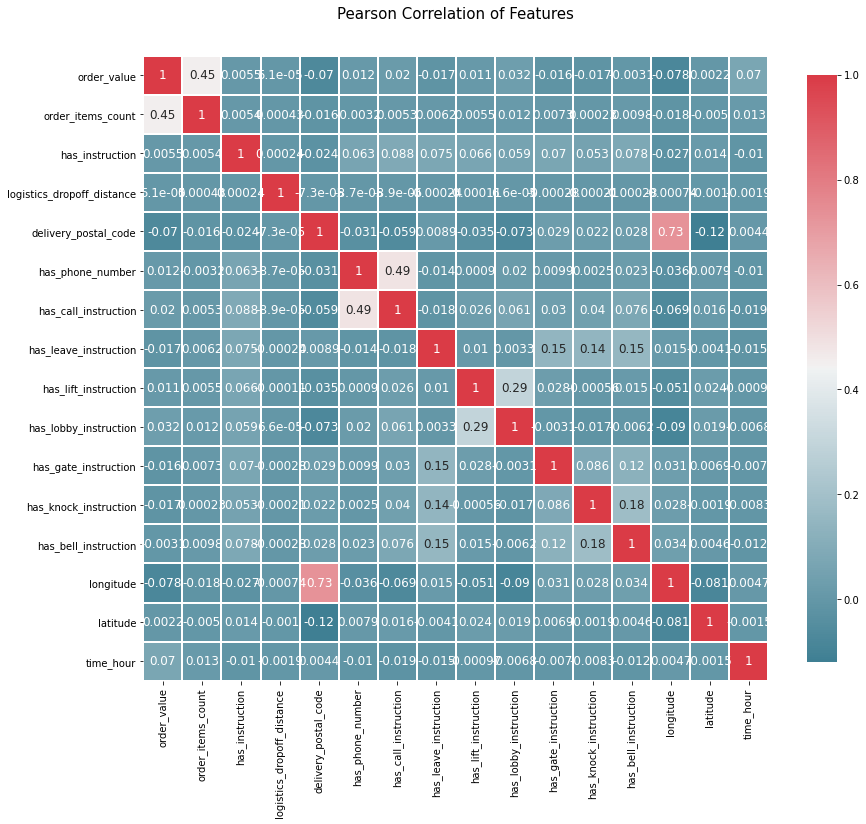

In [116]:
def correlation_heatmap(df):
    _ , ax = plt.subplots(figsize =(14, 12))
    colormap = sns.diverging_palette(220, 10, as_cmap = True)
    
    _ = sns.heatmap(
        df.corr(), 
        cmap = colormap,
        square=True, 
        cbar_kws={'shrink':.9 }, 
        ax=ax,
        annot=True, 
        linewidths=0.1,vmax=1.0, linecolor='white',
        annot_kws={'fontsize':12 }
    )
    
    plt.title('Pearson Correlation of Features', y=1.05, size=15)

correlation_heatmap(location_data)

we can observe following pairs of data are high correlated as comparision to others
1. has_phone_number and has_cell_instruction
2. order_value and order_items_count
3. has_lobby_instructions and has_lobby_instructions

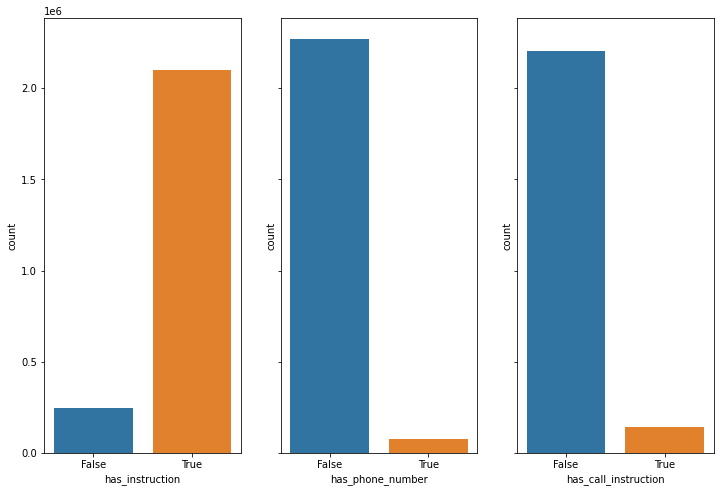

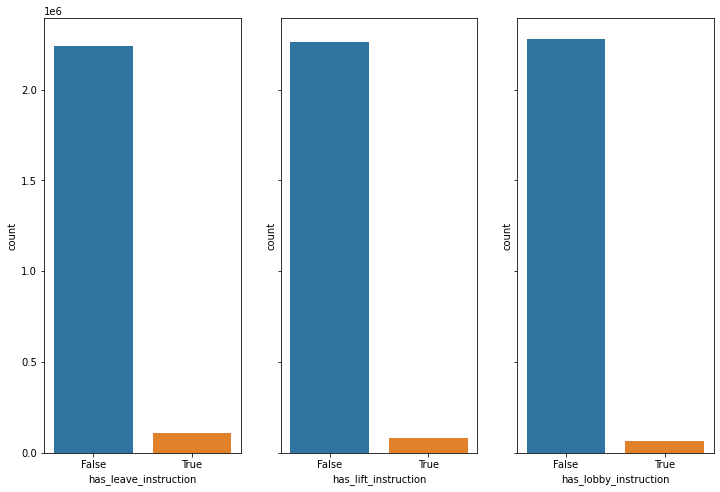

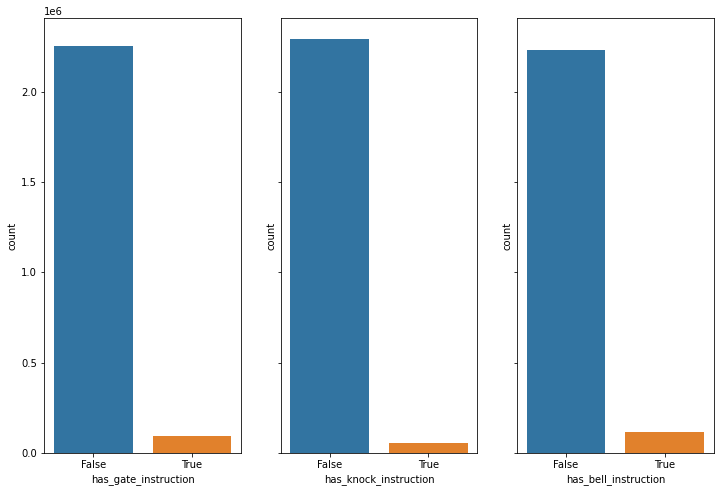

In [117]:
cols = location_data.select_dtypes(bool).columns

#Plot count plot for all attributes in a 3 x 3 grid
n_cols = 3
n_rows = 3
for i in range(n_rows):
    fg,ax = plt.subplots(nrows=1,ncols=n_cols,sharey=True,figsize=(12, 8))
    for j in range(n_cols):
        sns.countplot(x=cols[i*n_cols+j], data=location_data, ax=ax[j])

all boolean columns mostly have false value 

c:\users\rishikesh.kushwaha\appdata\local\programs\python\python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='logistics_dropoff_distance', ylabel='Density'>

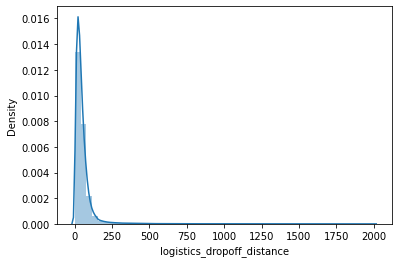

In [248]:
sns.distplot(location_data[location_data['logistics_dropoff_distance']<2000]['logistics_dropoff_distance'])

c:\users\rishikesh.kushwaha\appdata\local\programs\python\python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='logistics_dropoff_distance', ylabel='Density'>

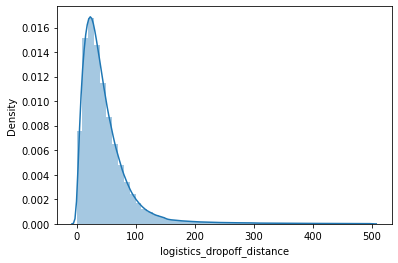

In [249]:
sns.distplot(location_data[location_data['logistics_dropoff_distance']<500]['logistics_dropoff_distance'])

In [150]:
location_data[location_data['logistics_dropoff_distance']>10000]

,order_id,order_value,order_items_count,customer_id,created_timestamp_local,has_instruction,logistics_dropoff_distance,delivery_postal_code,delivery_geohash_precision8,has_phone_number,...,minute,dow,tavg_x,tmin_x,tmax_x,prcp_x,tavg_y,tmin_y,tmax_y,prcp_y
777,y5qw-gjqz,47.44,10,sgirb2ws,2021-03-27 11:16:29,True,18629.541291,520810.0,w21ztjh7,False,...,16,5,26.6,25.0,30.3,0.0,26.6,25.0,30.3,0.0
994,x1lt-4cm7,253.68,21,h3aow9gb,2021-03-18 13:23:19,True,16514.089724,208315.0,w21z7jrv,False,...,23,3,28.5,25.4,32.4,0.5,28.5,25.4,32.4,0.5
3424,y2sf-jfko,21.88,11,sgvxn9xg,2021-03-17 16:14:22,False,19326.581153,640191.0,w21z8hc0,False,...,14,2,27.3,24.3,31.9,0.0,27.3,24.3,31.9,0.0
4656,x1lt-c6o8,74.39,12,s8uyj0ws1,2021-03-27 09:40:56,True,13667.508119,308365.0,w21z6zpv,False,...,40,5,26.6,25.0,30.3,0.0,26.6,25.0,30.3,0.0
5153,x1lt-q867,42.00,10,f0ohd0po,2021-03-22 13:35:46,True,13869.548307,338520.0,w21ze2xb,False,...,35,0,28.5,25.0,33.2,0.0,28.5,25.0,33.2,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2340446,v5zp-ihzs,21.50,9,r1xcj6wt,2021-03-08 18:44:47,True,10830.359433,787071.0,w21zfgfg,False,...,44,0,27.8,23.1,32.9,36.3,27.8,23.1,32.9,36.3
2344946,x0nc-ly94,18.60,9,t9gae5ca,2021-03-10 16:27:25,True,16684.412711,640632.0,w21xxsxu,False,...,27,2,28.4,24.9,33.1,0.0,28.4,24.9,33.1,0.0
2345194,s7kj-bmxi,125.00,9,sgkr2jvy,2021-03-22 22:16:35,True,12293.836837,79118.0,w21z5pfk,False,...,16,0,28.5,25.0,33.2,0.0,28.5,25.0,33.2,0.0
2345314,x1lt-acbs,99.75,9,sg6hivnr,2021-03-02 20:10:21,True,11566.244855,228220.0,w21z6y02,False,...,10,1,28.2,25.1,32.7,0.0,28.2,25.1,32.7,0.0


## Finding some relation in single day-data 

In [120]:
def extract_data(date, main_data):
    main_data['date'] = main_data['created_timestamp_local'].dt.date
    data = main_data[main_data['date']==  pd.to_datetime(date)]
    return data
date = datetime.datetime(2021,3,3)
data = extract_data(date, location_data)

c:\users\rishikesh.kushwaha\appdata\local\programs\python\python38\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



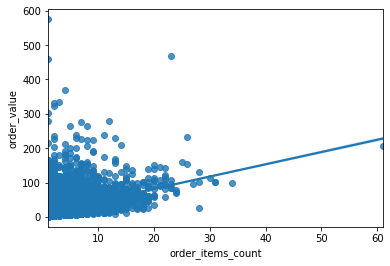

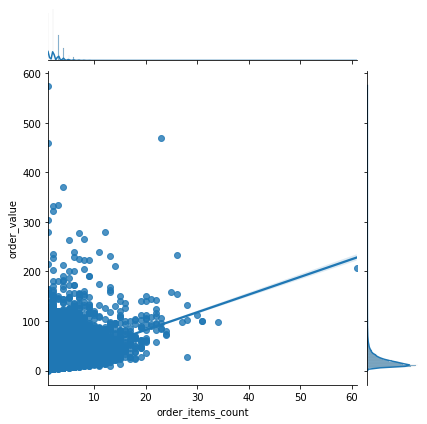

In [121]:
sns.regplot(x="order_items_count", y="order_value", data=data)
sns.jointplot("order_items_count", "order_value", data=data, kind='reg');

<AxesSubplot:xlabel='order_items_count', ylabel='order_value'>

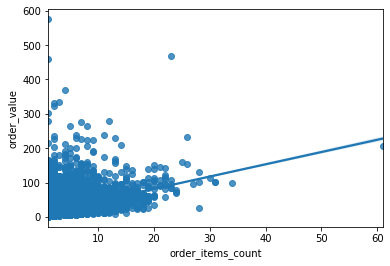

In [122]:
sns.regplot(x="order_items_count", y="order_value", data=data)

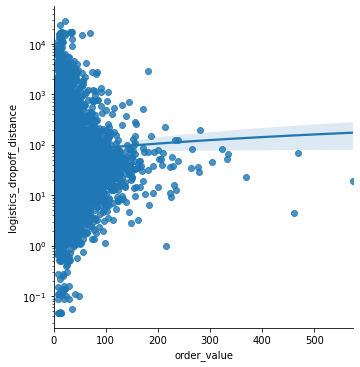

In [123]:
ax = sns.lmplot(y="logistics_dropoff_distance",x= "order_value", data=data[data['order_value']<2000])
ax.set(yscale='log')       

In [124]:
data.describe()

,order_value,order_items_count,logistics_dropoff_distance,delivery_postal_code,longitude,latitude,time_hour
count,74220.000000,74220.000000,74220.000000,7.422000e+04,74220.000000,74220.000000,74220.000000
mean,19.664390,2.481932,73.070582,5.153323e+05,1.358418,103.842590,14.713797
std,14.810414,1.889098,377.724295,2.143542e+05,0.047910,0.067127,4.919274
min,0.000000,1.000000,0.045846,0.000000e+00,1.239653,103.650684,0.000000
25%,10.850000,1.000000,21.511408,3.800598e+05,1.319818,103.795910,11.000000
50%,15.800000,2.000000,37.558414,5.401480e+05,1.352091,103.845005,15.000000
75%,23.540000,3.000000,62.260266,6.806160e+05,1.391401,103.894444,19.000000
max,575.000000,61.000000,28345.372167,7.300008e+06,1.469679,104.002934,23.000000


In [125]:
data['hour'] = data['created_timestamp_local'].dt.hour

<ipython-input-125-0849068fb1e6>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<AxesSubplot:xlabel='hour'>

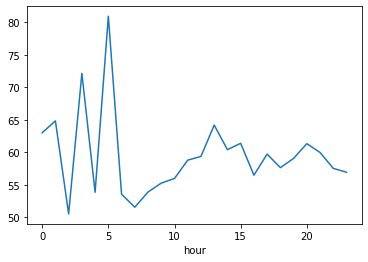

In [126]:
data[data['logistics_dropoff_distance']<2000].groupby('hour').agg(np.mean)['logistics_dropoff_distance'].plot()

In [127]:
data['time'] = data['created_timestamp_local'].dt.time

<ipython-input-127-4ad35120d6e1>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<AxesSubplot:xlabel='created_timestamp_local'>

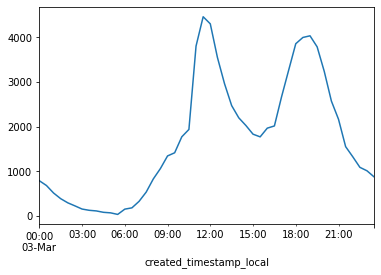

In [213]:
data[data['logistics_dropoff_distance']<2000].set_index('time').groupby(pd.Grouper(freq='30T',key='created_timestamp_local'))['order_id'].count().ffill().plot()

<AxesSubplot:xlabel='created_timestamp_local'>

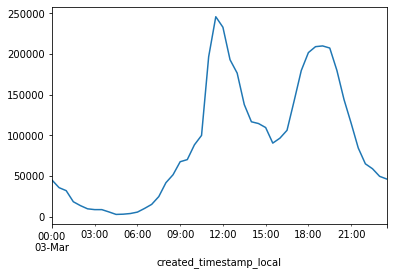

In [128]:
data[data['logistics_dropoff_distance']<2000].set_index('time').groupby(pd.Grouper(freq='30T',key='created_timestamp_local'))['logistics_dropoff_distance'].sum().ffill().plot()

<AxesSubplot:xlabel='created_timestamp_local'>

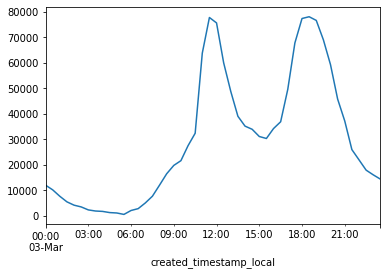

In [129]:
data[data['order_value']<100].set_index('time').groupby(pd.Grouper(freq='30T',key='created_timestamp_local'))['order_value'].sum().ffill().plot()

<AxesSubplot:xlabel='created_timestamp_local'>

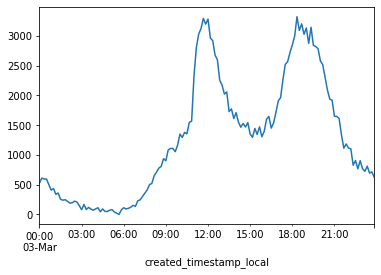

In [130]:
data[data['order_items_count']<100].set_index('time').groupby(pd.Grouper(freq='10T',key='created_timestamp_local'))['order_items_count'].sum().ffill().plot()

From above 3 plots we can say the mostly during lunch and dinner order volume are high 

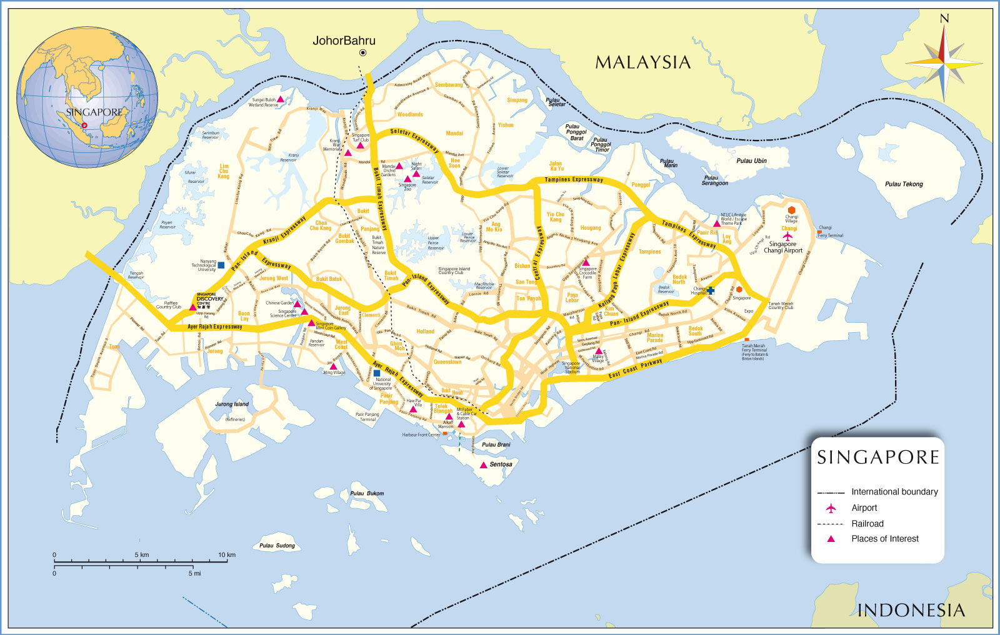

In [118]:
from IPython.display import Image
Image("singapore-map-1600px.jpg")

In [163]:
location_data['date'] = location_data['created_timestamp_local'].dt.date

In [164]:
location_data = location_data[location_data['date']== pd.to_datetime('2021-03-01')]

c:\users\rishikesh.kushwaha\appdata\local\programs\python\python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='logistics_dropoff_distance'>

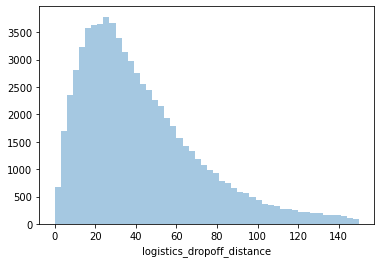

In [131]:
sns.distplot(data[data['logistics_dropoff_distance']<150]['logistics_dropoff_distance'],kde=False)

<AxesSubplot:xlabel='logistics_dropoff_distance', ylabel='Count'>

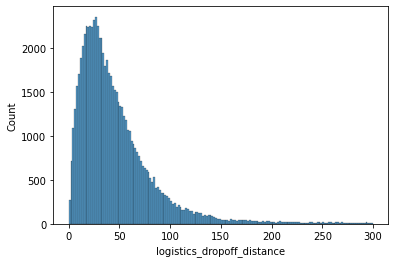

In [132]:
sns.histplot(data[data['logistics_dropoff_distance']<300]['logistics_dropoff_distance'],kde=False)

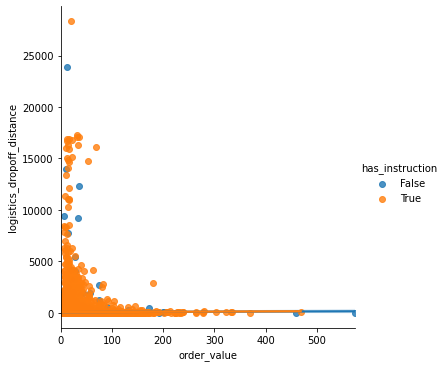

In [133]:
sns.lmplot(x="order_value", y="logistics_dropoff_distance", hue="has_instruction", data=data)


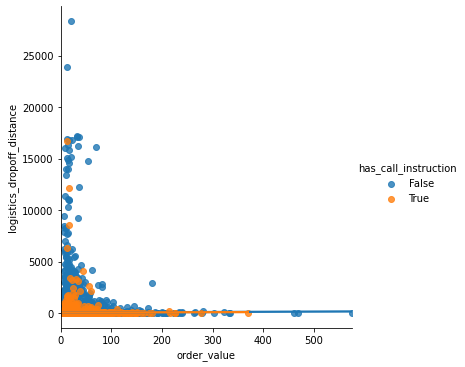

In [134]:
sns.lmplot(x="order_value", y="logistics_dropoff_distance", hue="has_call_instruction", data=data)

<AxesSubplot:xlabel='order_value', ylabel='Count'>

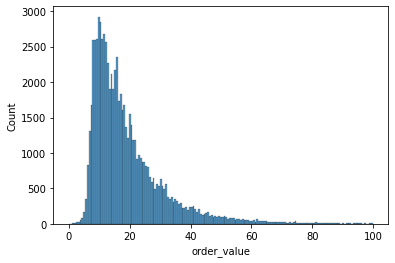

In [136]:
sns.histplot(data[data['order_value']<100], x="order_value")

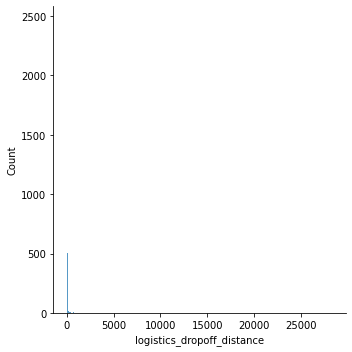

In [137]:
sns.displot(data, x="logistics_dropoff_distance", kind='hist')

<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5

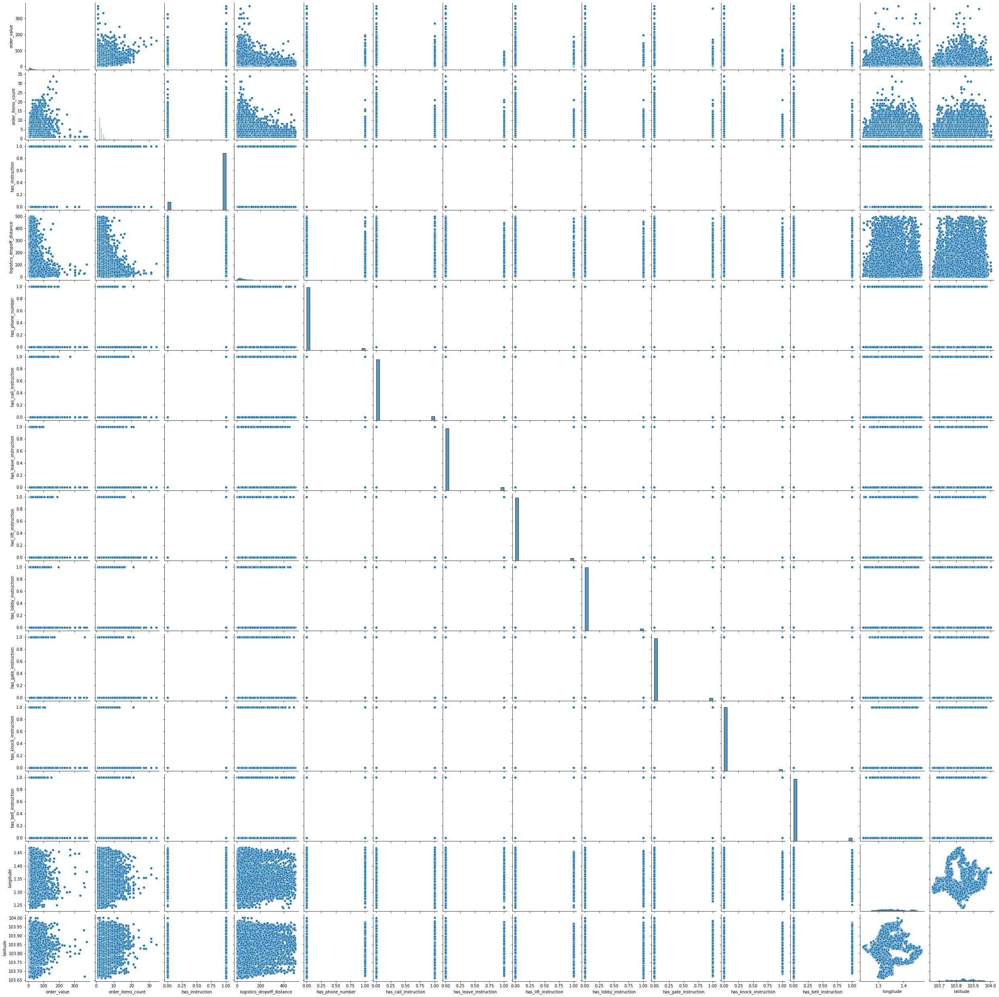

In [110]:
sns.pairplot(data)

In [138]:
location_data.head()

,order_id,order_value,order_items_count,customer_id,created_timestamp_local,has_instruction,logistics_dropoff_distance,delivery_postal_code,delivery_geohash_precision8,has_phone_number,...,has_lift_instruction,has_lobby_instruction,has_gate_instruction,has_knock_instruction,has_bell_instruction,location,longitude,latitude,date,time_hour
0,b8ds-tqhf,40.44,10,h6huq0td,2021-03-11 20:19:50,True,58.656138,828868.0,w23bh248,False,...,False,False,False,False,False,"Point(lat=Decimal('1.4063358306884765625'), lo...",1.406336,103.901310,2021-03-11,20
1,x5xx-j2d2,35.60,10,t2nod4rq,2021-03-12 18:42:48,True,39.025148,530548.0,w21zu55k,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3795566558837890625'), lo...",1.379557,103.891354,2021-03-12,18
2,x6qu-14kt,42.49,12,m4ycd3tm,2021-03-27 11:29:17,True,40.067811,650248.0,w21z9jc4,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3503742218017578125'), lo...",1.350374,103.756428,2021-03-27,11
3,x3yw-rhc5,14.40,11,sgmnf9sb,2021-03-02 22:08:52,True,44.986785,550105.0,w21zg97y,False,...,False,False,False,False,False,"Point(lat=Decimal('1.3702869415283203125'), lo...",1.370287,103.870068,2021-03-02,22
4,y9zp-58q7,38.15,10,x4rvv3iy,2021-03-23 20:35:26,True,71.520828,102112.0,w21z61q6,False,...,False,False,False,False,False,"Point(lat=Decimal('1.2817096710205078125'), lo...",1.281710,103.807583,2021-03-23,20


# Feature Engineering

In [182]:
location_data.columns

Index(['order_value', 'order_items_count', 'created_timestamp_local',
       'has_instruction', 'logistics_dropoff_distance', 'delivery_postal_code',
       'has_phone_number', 'has_call_instruction', 'has_leave_instruction',
       'has_lift_instruction', 'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction', 'longitude',
       'latitude', 'date', 'hour', 'minute', 'dow'],
      dtype='object')

In [181]:
location_data = location_data.drop(['prcp_x', 'tavg_x',
       'tmin_x', 'tmax_x', 'prcp_y', 'tavg_y', 'tmin_y', 'tmax_y', 'prcp'], axis = 1)


## Time feature

From EDA we can see that monthly and weekly pattern, which can cause possible deviation in dropoff distance

In [183]:
# include date, day and time feature into data
location_data['date'] = pd.to_datetime(location_data['created_timestamp_local'].dt.date)
location_data['hour'] = location_data['created_timestamp_local'].dt.hour
location_data['minute'] = location_data['created_timestamp_local'].dt.minute 
location_data['dow'] = location_data['created_timestamp_local'].dt.dayofweek

## Weather feature

In [184]:
weather_data = pd.read_csv('weather.csv')

In [185]:
# removing other information which is not necessary especially like snow, wind etc
weather_data = weather_data.drop(['snow','wpgt','tsun'], axis = 1)
# wind speed, direction and pres also not need, we can assume not going to effect dropoff distance
weather_data = weather_data.drop(['wdir','wspd','pres'], axis = 1)
weather_data


,date,tavg,tmin,tmax,prcp
0,3/1/2021,28.2,25.0,32.7,0.0
1,3/2/2021,28.2,25.1,32.7,0.0
2,3/3/2021,28.5,25.2,33.2,0.0
3,3/4/2021,28.7,25.7,33.1,0.0
4,3/5/2021,29.0,26.2,33.2,0.0
5,3/6/2021,29.1,26.1,33.3,0.0
6,3/7/2021,26.0,23.8,31.7,0.0
7,3/8/2021,27.8,23.1,32.9,36.3
8,3/9/2021,28.0,24.5,32.5,0.0
9,3/10/2021,28.4,24.9,33.1,0.0


In [186]:
# imputing using avg formula .. only one data is missing
weather_data.loc[29,'tmin'] = 2 * weather_data.iloc[29]['tavg'] - weather_data.iloc[29]['tmax']
weather_data

,date,tavg,tmin,tmax,prcp
0,3/1/2021,28.2,25.0,32.7,0.0
1,3/2/2021,28.2,25.1,32.7,0.0
2,3/3/2021,28.5,25.2,33.2,0.0
3,3/4/2021,28.7,25.7,33.1,0.0
4,3/5/2021,29.0,26.2,33.2,0.0
5,3/6/2021,29.1,26.1,33.3,0.0
6,3/7/2021,26.0,23.8,31.7,0.0
7,3/8/2021,27.8,23.1,32.9,36.3
8,3/9/2021,28.0,24.5,32.5,0.0
9,3/10/2021,28.4,24.9,33.1,0.0


In [187]:
weather_data['date'] = pd.to_datetime(weather_data['date'])
weather_data

,date,tavg,tmin,tmax,prcp
0,2021-03-01,28.2,25.0,32.7,0.0
1,2021-03-02,28.2,25.1,32.7,0.0
2,2021-03-03,28.5,25.2,33.2,0.0
3,2021-03-04,28.7,25.7,33.1,0.0
4,2021-03-05,29.0,26.2,33.2,0.0
5,2021-03-06,29.1,26.1,33.3,0.0
6,2021-03-07,26.0,23.8,31.7,0.0
7,2021-03-08,27.8,23.1,32.9,36.3
8,2021-03-09,28.0,24.5,32.5,0.0
9,2021-03-10,28.4,24.9,33.1,0.0


In [188]:
location_data = pd.merge(location_data, weather_data, how='left', on=['date'])

# Modelling

## Data Preparation

In [189]:
# Encoding for boolean vaiables
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()

for col in location_data.select_dtypes(bool).columns:
    location_data[col] = label_encoder.fit_transform(location_data[col])


In [190]:
# customer id and order id -- not need to include into model  
location_data = location_data.drop(['order_id', 'customer_id'], axis=1)

KeyError: "['order_id' 'customer_id'] not found in axis"

In [157]:
# delivery hashcode also not needed 
location_data = location_data.drop(['location','delivery_geohash_precision8'], axis=1)

In [158]:
# remove time_hour and hour both are same 
location_data = location_data.drop(['time_hour'], axis=1)

In [ ]:
location_data = location_data.drop([''])

In [191]:
# Train set = data from 1-03-2021 to 23-03-2021
# Test Set = data from 24-03-2021 to 31-03-2021, excluding data of april for testing 
split_date = datetime.datetime(2021,3,23)
train_end = datetime.datetime(2021,3,31)
train_data = location_data[location_data['date']<=split_date]
test_data = location_data[(location_data['date']>split_date)&(location_data['date']<=train_end)]


In [192]:
train_data.shape

(1773179, 24)

In [193]:
test_data.shape

(570570, 24)

In [194]:
train_data.dtypes

order_value                          float64
order_items_count                      int64
created_timestamp_local       datetime64[ns]
has_instruction                        int64
logistics_dropoff_distance           float64
delivery_postal_code                 float64
has_phone_number                       int64
has_call_instruction                   int64
has_leave_instruction                  int64
has_lift_instruction                   int64
has_lobby_instruction                  int64
has_gate_instruction                   int64
has_knock_instruction                  int64
has_bell_instruction                   int64
longitude                            float64
latitude                             float64
date                          datetime64[ns]
hour                                   int64
minute                                 int64
dow                                    int64
tavg                                 float64
tmin                                 float64
tmax      

In [195]:
feature_col = ['order_value', 'order_items_count',
       'has_instruction', 'delivery_postal_code',
       'has_phone_number', 'has_call_instruction', 'has_leave_instruction',
       'has_lift_instruction', 'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude', 'hour', 'minute', 'dow', 'tavg',
       'tmin', 'tmax', 'prcp']
predict_col = ['logistics_dropoff_distance']

## Regression Models

In [230]:
result_df = []

In [232]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_squared_log_error

model = LinearRegression(n_jobs=-1)
model.fit(train_data[feature_col],train_data[predict_col])
result_df.append({'model': 'Linear', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

In [234]:
from sklearn.linear_model import Ridge
model = Ridge()
model.fit(train_data[feature_col],train_data[predict_col])
mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col])))
result_df.append({'model': 'Ridge', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

In [236]:
from sklearn.linear_model import Lasso
model = Lasso()
model.fit(train_data[feature_col],train_data[predict_col])
result_df.append({'model': 'Lasso', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

In [237]:
from sklearn.linear_model import ElasticNet
model = ElasticNet()
model.fit(train_data[feature_col],train_data[predict_col])
mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col])))
result_df.append({'model': 'ElasticNet', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

In [238]:
from sklearn.neighbors import KNeighborsRegressor
model = KNeighborsRegressor()
model.fit(train_data[feature_col],train_data[predict_col])
mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col])))
result_df.append({'model': 'KNeighborsRegressor', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

In [239]:
from sklearn.tree import DecisionTreeRegressor
model = DecisionTreeRegressor()
model.fit(train_data[feature_col],train_data[predict_col])
result_df.append({'model': 'DecisionTreeRegressor', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

In [241]:
from sklearn.ensemble import GradientBoostingRegressor
model = GradientBoostingRegressor(n_estimators=24, random_state=40)
model.fit(train_data[feature_col],train_data[predict_col])
result_df.append({'model': 'GradientBoostingRegressor', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

In [242]:
from xgboost import XGBRegressor
model = XGBRegressor(n_estimators=n_estimators,seed=40)
model.fit(train_data[feature_col],train_data[predict_col])
result_df.append({'model': 'XGBRegressor', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

In [244]:
from sklearn.ensemble import AdaBoostRegressor
model = AdaBoostRegressor(n_estimators=n_estimators)
model.fit(train_data[feature_col],train_data[predict_col])
result_df.append({'model': 'AdaBoostRegressor', 
                  'MAE': mean_absolute_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'MSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col]))),
                 'RMSE': mean_squared_error((test_data[predict_col]),(model.predict(test_data[feature_col])))**0.5,
                 })

AdaBoostRegressor(n_estimators=23)

In [264]:
# pd.DataFrame(result_df).set_index('model')['MSE'].plot(kind='bar')

<AxesSubplot:xlabel='model'>

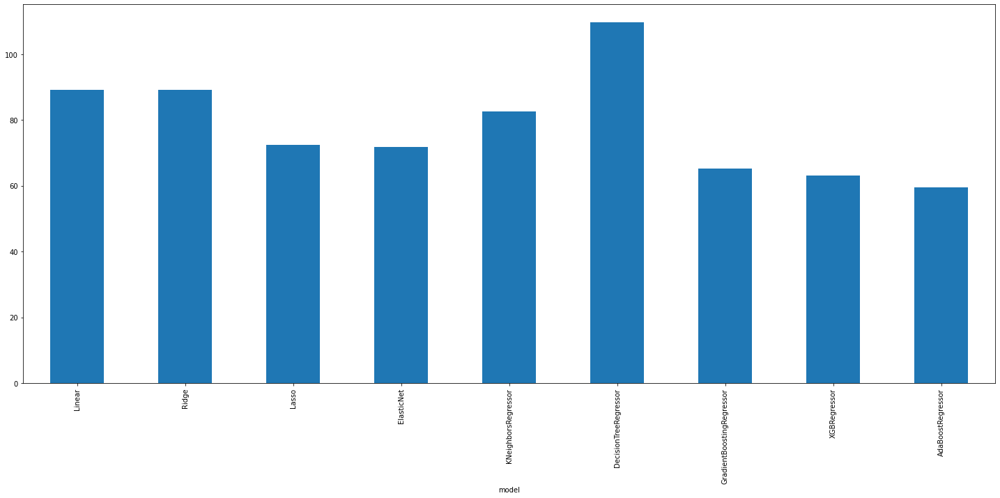

In [265]:
pd.DataFrame(result_df).set_index('model')['MAE'].plot(kind='bar')

In [266]:
pd.DataFrame(result_df).sort_values('MAE')

,model,MAE,MSE,RMSE
8,AdaBoostRegressor,59.463869,1.426452e+05,377.683958
7,XGBRegressor,63.202696,1.472733e+05,383.761987
6,GradientBoostingRegressor,65.277201,1.552296e+05,393.991827
3,ElasticNet,71.709207,1.436453e+05,379.005731
2,Lasso,72.347757,1.436993e+05,379.076900
4,KNeighborsRegressor,82.597695,1.801086e+07,4243.920271
1,Ridge,89.099332,1.453813e+05,381.288935
0,Linear,89.099997,1.453814e+05,381.289167
5,DecisionTreeRegressor,109.635570,4.345815e+05,659.227977


In [50]:
from pycaret.regression import *
exp_reg101 = setup(data = location_data[feature_col+predict_col], target = 'logistics_dropoff_distance', session_id=123)

,Description,Value
0,session_id,123
1,Target,logistics_dropoff_distance
2,Original Data,"(2347899, 22)"
3,Missing Values,True
4,Numeric Features,11
5,Categorical Features,10
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(1643529, 27)"


In [ ]:
best = compare_models(exclude = ['ransac'])

IntProgress(value=0, description='Processing: ', max=89)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,22:45:39
Status,. . . . . . . . . . . . . . . . . .,Fitting 10 Folds
Estimator,. . . . . . . . . . . . . . . . . .,Random Forest Regressor


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
llar,Lasso Least Angle Regression,77.0139,140042518.9319,4060.6886,-0.0008,1.1806,3.4534,0.4030
br,Bayesian Ridge,77.0194,140042593.3675,4060.6896,-0.0008,1.1805,3.4609,2.4010
en,Elastic Net,79.9219,140043509.9844,4061.8440,-0.0073,1.1989,3.5776,51.6850
huber,Huber Regressor,59.1292,140044195.1789,4061.9672,-0.0079,0.9040,1.4517,6.8720
lasso,Lasso Regression,81.6554,140044020.8055,4062.5594,-0.0114,1.2122,3.5799,20.2600
omp,Orthogonal Matching Pursuit,81.3252,140043809.1722,4062.5652,-0.0114,1.2041,3.4128,0.2090
lr,Linear Regression,84.2677,140044369.9086,4063.2249,-0.0152,1.2667,3.6721,1.3250
ridge,Ridge Regression,84.2627,140044370.3977,4063.2256,-0.0152,1.2666,3.6716,0.3620
lar,Least Angle Regression,84.3251,140044398.3011,4063.2436,-0.0153,1.2678,3.6749,0.6460
par,Passive Aggressive Regressor,114.3328,140057326.3457,4079.8138,-0.1258,1.3491,4.5197,0.9850


# Conclusion

## Result and Comment 

In this notebook, we aimed to find some relation between dropoff distance and other variables

External features like temperature and precipitation also taken into account. 

The added time and feature (date, month, time, day of week) and weather (tavg, tmin, tmax also feature temperature, prcp = precipitation, etc). All the features are used (some are correlated to each other, can be removed to make faster training)

Divided train period to be first 23 days and testing period to be next 7 days and excluded 1st April data in modelling 

Tried traditional regression methods, using skit-learn, and Pycaret, are used to model, and for selection of best model MAE, MSE, and RMSE calculated

AdaBoostRegressor, XGBRegressor and GradientBoostingRegressor models are performing well in the default settings, based on MAE.

In the Pycaret framework, Lasso Least Angle Regression, Bayesian Ridge and Elastic Net perform better than others.



## Suggestion for improvement from UI design prospective

1. Include UI/UX design to provide landmark information
2. Can provide map to customer to tell exact location.


## Other factors to imporve prediction of dropoff distance 
1. Traffic information
2. Area information - residential/ commercial etc
3. Road Network information

In [ ]:
# Here some efforts to solve this problem as unsupervised learning 

In [135]:
# from sklearn.datasets import fetch_mldata
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

In [137]:
temp_data.columns

Index(['order_id', 'order_value', 'order_items_count', 'customer_id',
       'created_timestamp_local', 'has_instruction',
       'logistics_dropoff_distance', 'delivery_postal_code',
       'delivery_geohash_precision8', 'has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction', 'location', 'date',
       'longitude', 'latitude'],
      dtype='object')

In [167]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(temp_data[['order_value', 'order_items_count','has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude']].values)

In [163]:
df = pd.DataFrame()

In [168]:
temp_data['pca-one'] = pca_result[:,0]
temp_data['pca-two'] = pca_result[:,1] 
temp_data['pca-three'] = pca_result[:,2]
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

Explained variation per principal component: [9.86334611e-01 1.22425512e-02 3.25214200e-04]


In [169]:
temp_data

,order_id,order_value,order_items_count,customer_id,created_timestamp_local,has_instruction,logistics_dropoff_distance,delivery_postal_code,delivery_geohash_precision8,has_phone_number,...,has_gate_instruction,has_knock_instruction,has_bell_instruction,location,date,longitude,latitude,pca-one,pca-two,pca-three
100,d3nr-wb7g,35.16,11,sgrqf2nl,2021-03-01 13:03:22,True,18.616346,530606,w21zgcx3,False,...,False,False,False,"(1.3708019256591796875, 103.885860443115234375)",2021-03-01,1.370802,103.885860,15.919768,7.632453,-0.096647
187,i1cb-lkrn,48.60,13,s5ltw1lm,2021-03-01 19:21:37,True,53.420732,460557,w21zsfdh,False,...,True,False,False,"(1.3328647613525390625, 103.922595977783203125)",2021-03-01,1.332865,103.922596,29.452149,8.860672,-0.014936
202,x1sy-b25o,30.40,11,sgjmz9ib,2021-03-01 21:53:43,True,19.538711,750332,w23b4rm5,False,...,False,False,False,"(1.4466762542724609375, 103.816852569580078125)",2021-03-01,1.446676,103.816853,11.167570,7.905255,-0.096403
301,x8yk-kb9r,25.29,10,m2rsq4xh,2021-03-01 14:45:05,True,2.008922,762501,w23b4cyq,False,...,False,False,False,"(1.4169788360595703125, 103.840541839599609375)",2021-03-01,1.416979,103.840542,6.008673,7.199697,-0.093966
304,v1zb-5ifr,140.33,12,sgopht3n,2021-03-01 11:32:46,True,57.460436,018960,w21z70wr,False,...,False,False,False,"(1.2784481048583984375, 103.851528167724609375)",2021-03-01,1.278448,103.851528,120.974256,2.604357,-0.128757
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2593655,x7hz-61a5,23.80,9,c5eiu1cj,2021-03-01 19:42:43,True,9.528812,418510,w21zs9vp,True,...,False,False,False,"(1.3292598724365234375, 103.915729522705078125)",2021-03-01,1.329260,103.915730,4.464259,6.286166,1.222568
2593697,y6yq-rj57,68.03,9,j8omc2ok,2021-03-01 09:49:36,True,45.686575,822126,w21zutcu,False,...,False,True,True,"(1.3946628570556640625, 103.911266326904296875)",2021-03-01,1.394663,103.911266,48.621321,3.755001,0.990238
2593724,y1rk-c60l,11.20,9,w7gse0cn,2021-03-01 10:13:52,True,45.832599,430005,w21zknzn,False,...,False,False,False,"(1.3126087188720703125, 103.896503448486328125)",2021-03-01,1.312609,103.896503,-8.115082,7.008963,0.773246
2593760,x1lt-se3i,32.49,9,sg3cslm8,2021-03-01 19:16:05,True,11.356287,308349,w21z6zrv,True,...,False,False,False,"(1.3151836395263671875, 103.842601776123046875)",2021-03-01,1.315184,103.842602,13.139980,5.788218,1.219683


<AxesSubplot:xlabel='pca-one', ylabel='pca-two'>

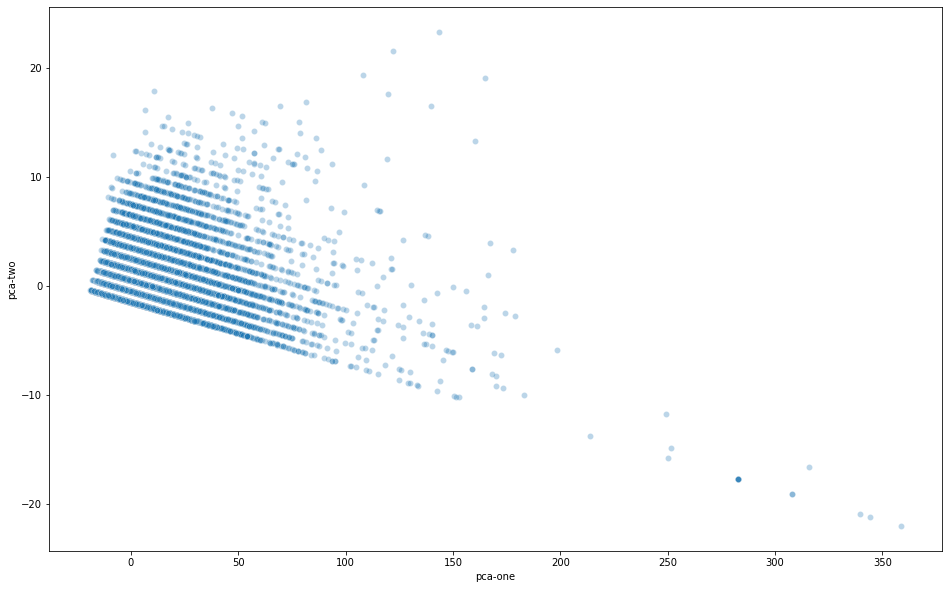

In [170]:
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="pca-one", y="pca-two",
#     hue="y",
    palette=sns.color_palette("hls", 10),
    data=temp_data[['order_value', 'order_items_count','has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude','pca-one','pca-two','pca-three']],
    legend="full",
    alpha=0.3
)

<ipython-input-171-0800209eb038>:1: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = plt.figure(figsize=(16,10)).gca(projection='3d')


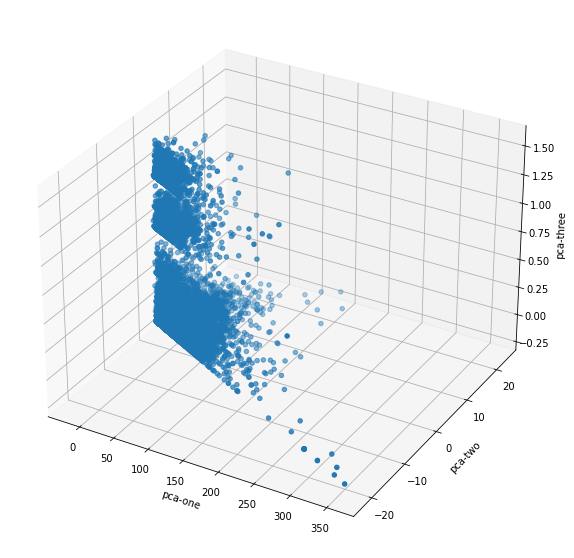

In [171]:
ax = plt.figure(figsize=(16,10)).gca(projection='3d')
ax.scatter(
    xs=temp_data[['has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude','pca-one','pca-two','pca-three']]["pca-one"], 
    ys=temp_data[['has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude','pca-one','pca-two','pca-three']]["pca-two"], 
    zs=temp_data[['has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude','pca-one','pca-two','pca-three']]["pca-three"], 
#     c=df.loc[rndperm,:]["y"], 
    cmap='tab10'
)
ax.set_xlabel('pca-one')
ax.set_ylabel('pca-two')
ax.set_zlabel('pca-three')
plt.show()

In [178]:
temp_data[temp_data['pca-one']>100][['has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',]]

,has_phone_number,has_call_instruction,has_leave_instruction,has_lift_instruction,has_lobby_instruction,has_gate_instruction,has_knock_instruction,has_bell_instruction
304,False,False,False,False,False,False,False,False
2380,False,False,False,False,False,False,False,False
2720,False,False,False,False,False,False,False,False
4083,False,False,False,False,False,False,False,False
4235,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...
2574906,False,False,False,False,False,False,False,False
2578138,False,True,False,False,False,False,False,False
2579933,False,False,False,False,False,False,False,False
2583657,False,False,False,False,False,False,False,False


In [176]:
temp_data['sum'] = temp_data[['has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',]].astype(int).sum(axis=1)

In [183]:
temp_data.to_csv('temp_data.csv')

In [2]:
temp_data = pd.read_csv('temp_data.csv')

In [6]:
temp_data[['has_instruction','has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',]]= temp_data[['has_instruction','has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',]].astype(int)

In [10]:
del temp_data['Unnamed: 0']

In [14]:
temp_data.columns

Index(['order_id', 'order_value', 'order_items_count', 'customer_id',
       'created_timestamp_local', 'has_instruction',
       'logistics_dropoff_distance', 'delivery_postal_code',
       'delivery_geohash_precision8', 'has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction', 'location', 'date',
       'longitude', 'latitude', 'pca-one', 'pca-two', 'pca-three', 'sum'],
      dtype='object')

In [15]:
features_cols = [ 'order_value', 'order_items_count', 'has_instruction',
       'logistics_dropoff_distance', 'delivery_postal_code', 'has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude',]

In [16]:
from pycaret.anomaly import *
exp_ano = setup(temp_data[[ 'order_value', 'order_items_count', 'has_instruction',
       'logistics_dropoff_distance', 'delivery_postal_code', 'has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude',]])


,Description,Value
0,session_id,2377
1,Original Data,"(64589, 15)"
2,Missing Values,False
3,Numeric Features,15
4,Categorical Features,0
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(64589, 15)"
9,CPU Jobs,-1


In [17]:
iforest=create_model('iforest')
## plotting a model
plot_model(iforest)

In [18]:
forest_predictions = predict_model(iforest, data = temp_data[[ 'order_value', 'order_items_count', 'has_instruction',
       'logistics_dropoff_distance', 'delivery_postal_code', 'has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude',]])


In [26]:
3230/len(temp_data)

0.05000851538187617

In [25]:
forest_predictions[(forest_predictions['Anomaly']==1)]

,order_value,order_items_count,has_instruction,logistics_dropoff_distance,delivery_postal_code,has_phone_number,has_call_instruction,has_leave_instruction,has_lift_instruction,has_lobby_instruction,has_gate_instruction,has_knock_instruction,has_bell_instruction,longitude,latitude,Anomaly,Anomaly_Score
4,140.33,12,1,57.460436,18960,0,0,0,0,0,0,0,0,1.278448,103.851528,1,0.014571
18,33.10,11,1,21.316206,520368,0,0,0,0,0,1,0,0,1.358786,103.961048,1,0.001382
30,45.50,11,1,46.720243,760148,0,0,0,1,0,0,0,0,1.431913,103.832302,1,0.000022
45,31.10,12,1,75.275624,510114,0,0,1,0,0,0,0,1,1.368399,103.955212,1,0.049401
52,127.55,18,1,14.969665,467201,0,0,0,0,0,0,0,0,1.316214,103.942852,1,0.008998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64582,20.10,9,1,13.253361,228577,0,1,0,0,0,0,0,1,1.309690,103.839855,1,0.033768
64583,24.10,9,1,36.691324,418924,1,1,0,0,0,0,0,0,1.319475,103.912296,1,0.017098
64584,23.80,9,1,9.528812,418510,1,1,0,0,0,0,0,0,1.329260,103.915730,1,0.020864
64585,68.03,9,1,45.686575,822126,0,1,0,0,0,0,1,1,1.394663,103.911266,1,0.128614


In [27]:
knn=create_model('knn')
## plotting a model
plot_model(knn)

In [28]:
knn_predictions = predict_model(knn, data = temp_data[[ 'order_value', 'order_items_count', 'has_instruction',
       'logistics_dropoff_distance', 'delivery_postal_code', 'has_phone_number',
       'has_call_instruction', 'has_leave_instruction', 'has_lift_instruction',
       'has_lobby_instruction', 'has_gate_instruction',
       'has_knock_instruction', 'has_bell_instruction',
       'longitude', 'latitude',]])


In [29]:
knn_predictions[(knn_predictions['Anomaly']==1)]

,order_value,order_items_count,has_instruction,logistics_dropoff_distance,delivery_postal_code,has_phone_number,has_call_instruction,has_leave_instruction,has_lift_instruction,has_lobby_instruction,has_gate_instruction,has_knock_instruction,has_bell_instruction,longitude,latitude,Anomaly,Anomaly_Score
42,103.00,11,1,129.337525,568429,0,0,0,0,0,0,0,0,1.352606,103.862514,1,121.577735
46,47.00,10,1,50.996267,249285,0,0,0,0,0,0,0,0,1.300764,103.826466,1,83.303195
52,127.55,18,1,14.969665,467201,0,0,0,0,0,0,0,0,1.316214,103.942852,1,96.282445
64,140.40,31,0,26.637667,557595,0,0,0,0,0,0,0,0,1.367025,103.865604,1,160.470376
68,32.50,16,1,59.607162,409668,0,0,0,0,0,0,0,0,1.321363,103.896503,1,84.855645
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64547,28.30,9,1,247.814181,427873,0,0,0,0,0,1,0,0,1.313982,103.903713,1,204.395995
64551,28.40,9,1,309.523254,638351,0,0,0,0,0,0,0,0,1.333036,103.689823,1,250.194650
64573,18.40,9,1,80.947320,728777,0,1,0,0,0,1,0,0,1.405993,103.750935,1,90.032575
64574,48.70,9,1,133.786852,258541,1,1,0,0,0,1,0,0,1.322393,103.823376,1,92.072367


In [36]:
len(set(forest_predictions[(forest_predictions['Anomaly']==1)].index).intersection(set(knn_predictions[(knn_predictions['Anomaly']==1)].index)))

283

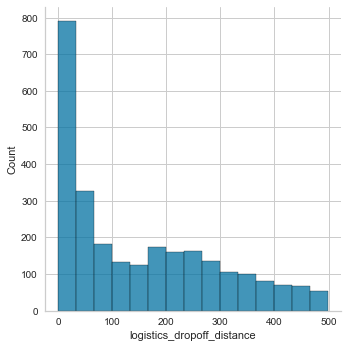

In [38]:
sns.displot(knn_predictions[(knn_predictions['Anomaly']==1)], x = 'logistics_dropoff_distance' )

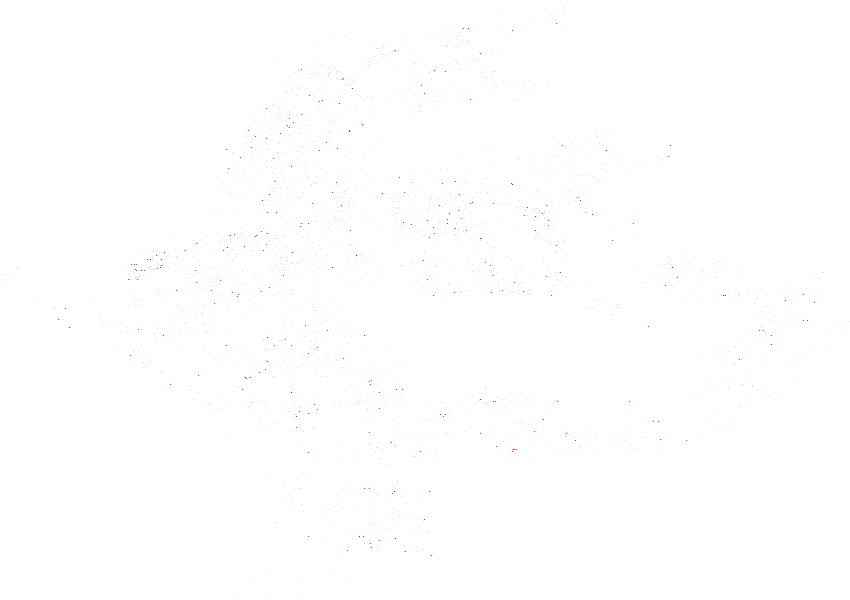

In [46]:
cvs = ds.Canvas(plot_width=850, plot_height=600)
agg = cvs.points(knn_predictions[(knn_predictions['Anomaly']==1)], 'longitude', 'latitude')
img = ds.tf.shade(agg, cmap='red')
img

<AxesSubplot:ylabel='Frequency'>

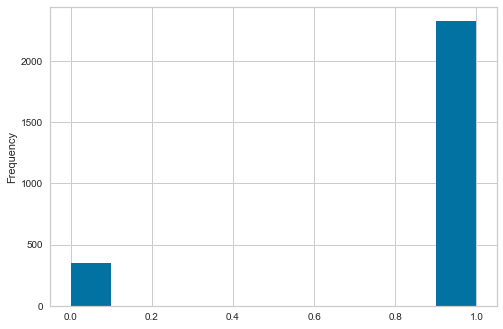

In [53]:
knn_predictions[(knn_predictions['Anomaly']==1)]['has_instruction'].plot(kind='hist')

In [66]:
population_data = pd.read_csv('population_area_wise.csv', skiprows=5,skipfooter=12)

In [82]:
postcode = pd.read_csv('postcode.csv')
postcode['street /address'][0]

'Battery Road'

In [80]:
list_area = population_data['   ']

In [95]:
from difflib import get_close_matches
for i in range(len(postcode)):
    print(postcode['street /address'][i], get_close_matches(postcode['street /address'][i], list_area))

Battery Road []
Cecil Street []
Cross Street []
Eu Tong Sen Street []
Havelock Road []
Marina []
Maxwell []
New Bridge []
Raffles Link/ Place ['         Raffles Place ']
Republic Blvd []
Robinson []
South Bridge Road []
Telok Ayer []
Temasek Ave []
Temasek Blvd []
Upper Cross St []
Upper Pickering Street []
Anson []
Keppel []
Prince Edward Rd []
New Bridge Road []
Shenton Way []
Tanjong Pagar ['         Tanjong Pagar ']
Tras St []
Alexandra Rd []
Bukit Merah ['         Bukit Merah ', '     Bukit Merah- Total ']
Chin Swee Rd []
Commonwealth ['         Commonwealth ']
Delta Avenue []
Havelock Road []
Henderson Road []
Jalan Bukit Merah ['         Bukit Merah ']
Kim Tian Road []
Leng Kee Road []
Margaret Dr ['         Margaret Drive ']
Outram Rd []
Queensway ['         Queensway ']
Redhill []
Tiong Bahru ['         Tiong Bahru ']
Bukit Purmei []
Harbourfront []
Lock Road []
Maritime Square ['         Maritime Square ']
Telok Blangah ['         Telok Blangah Way ', '         Telok Blangah 

In [102]:
population_density = pd.read_csv('.\\population_sgp_2018-10-01\\population_sgp_2018-10-01.csv')

In [115]:
temp_data.head()

,order_id,order_value,order_items_count,customer_id,created_timestamp_local,has_instruction,logistics_dropoff_distance,delivery_postal_code,delivery_geohash_precision8,has_phone_number,...,has_knock_instruction,has_bell_instruction,location,date,longitude,latitude,pca-one,pca-two,pca-three,sum
0,d3nr-wb7g,35.16,11,sgrqf2nl,2021-03-01 13:03:22,1,18.616346,530606,w21zgcx3,0,...,0,0,"Point(lat=Decimal('1.3708019256591796875'), lo...",2021-03-01,1.370802,103.885860,15.919768,7.632453,-0.096647,0
1,i1cb-lkrn,48.60,13,s5ltw1lm,2021-03-01 19:21:37,1,53.420732,460557,w21zsfdh,0,...,0,0,"Point(lat=Decimal('1.3328647613525390625'), lo...",2021-03-01,1.332865,103.922596,29.452149,8.860672,-0.014936,1
2,x1sy-b25o,30.40,11,sgjmz9ib,2021-03-01 21:53:43,1,19.538711,750332,w23b4rm5,0,...,0,0,"Point(lat=Decimal('1.4466762542724609375'), lo...",2021-03-01,1.446676,103.816853,11.167570,7.905255,-0.096403,0
3,x8yk-kb9r,25.29,10,m2rsq4xh,2021-03-01 14:45:05,1,2.008922,762501,w23b4cyq,0,...,0,0,"Point(lat=Decimal('1.4169788360595703125'), lo...",2021-03-01,1.416979,103.840542,6.008673,7.199697,-0.093966,0
4,v1zb-5ifr,140.33,12,sgopht3n,2021-03-01 11:32:46,1,57.460436,18960,w21z70wr,0,...,0,0,"Point(lat=Decimal('1.2784481048583984375'), lo...",2021-03-01,1.278448,103.851528,120.974256,2.604357,-0.128757,0


In [116]:
temp_data.merge(population_density,how='left',on=['latitude','longitude'])

,order_id,order_value,order_items_count,customer_id,created_timestamp_local,has_instruction,logistics_dropoff_distance,delivery_postal_code,delivery_geohash_precision8,has_phone_number,...,location,date,longitude,latitude,pca-one,pca-two,pca-three,sum,population_2015,population_2020
0,d3nr-wb7g,35.16,11,sgrqf2nl,2021-03-01 13:03:22,1,18.616346,530606,w21zgcx3,0,...,"Point(lat=Decimal('1.3708019256591796875'), lo...",2021-03-01,1.370802,103.885860,15.919768,7.632453,-0.096647,0,NaN,NaN
1,i1cb-lkrn,48.60,13,s5ltw1lm,2021-03-01 19:21:37,1,53.420732,460557,w21zsfdh,0,...,"Point(lat=Decimal('1.3328647613525390625'), lo...",2021-03-01,1.332865,103.922596,29.452149,8.860672,-0.014936,1,NaN,NaN
2,x1sy-b25o,30.40,11,sgjmz9ib,2021-03-01 21:53:43,1,19.538711,750332,w23b4rm5,0,...,"Point(lat=Decimal('1.4466762542724609375'), lo...",2021-03-01,1.446676,103.816853,11.167570,7.905255,-0.096403,0,NaN,NaN
3,x8yk-kb9r,25.29,10,m2rsq4xh,2021-03-01 14:45:05,1,2.008922,762501,w23b4cyq,0,...,"Point(lat=Decimal('1.4169788360595703125'), lo...",2021-03-01,1.416979,103.840542,6.008673,7.199697,-0.093966,0,NaN,NaN
4,v1zb-5ifr,140.33,12,sgopht3n,2021-03-01 11:32:46,1,57.460436,18960,w21z70wr,0,...,"Point(lat=Decimal('1.2784481048583984375'), lo...",2021-03-01,1.278448,103.851528,120.974256,2.604357,-0.128757,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64584,x7hz-61a5,23.80,9,c5eiu1cj,2021-03-01 19:42:43,1,9.528812,418510,w21zs9vp,1,...,"Point(lat=Decimal('1.3292598724365234375'), lo...",2021-03-01,1.329260,103.915730,4.464259,6.286166,1.222568,2,NaN,NaN
64585,y6yq-rj57,68.03,9,j8omc2ok,2021-03-01 09:49:36,1,45.686575,822126,w21zutcu,0,...,"Point(lat=Decimal('1.3946628570556640625'), lo...",2021-03-01,1.394663,103.911266,48.621321,3.755001,0.990238,3,NaN,NaN
64586,y1rk-c60l,11.20,9,w7gse0cn,2021-03-01 10:13:52,1,45.832599,430005,w21zknzn,0,...,"Point(lat=Decimal('1.3126087188720703125'), lo...",2021-03-01,1.312609,103.896503,-8.115082,7.008963,0.773246,1,NaN,NaN
64587,x1lt-se3i,32.49,9,sg3cslm8,2021-03-01 19:16:05,1,11.356287,308349,w21z6zrv,1,...,"Point(lat=Decimal('1.3151836395263671875'), lo...",2021-03-01,1.315184,103.842602,13.139980,5.788218,1.219683,2,NaN,NaN
